In [9]:
import os
if 'examples' in os.getcwd(): os.chdir('../../')
print(os.getcwd())

/home/bernie40916/Nas/home/Project/DJtransGAN


In [10]:
import warnings
warnings.filterwarnings('ignore')

In [11]:
import torch
import matplotlib.pyplot as plt

from djtransgan.config  import settings
from djtransgan.utils   import time_to_str, squeeze_dim, load_pt, load_audio, out_audio
from djtransgan.utils   import audio_visualize, wave_visualize
from djtransgan.utils   import download_pretrained
from djtransgan.model   import get_generator
from djtransgan.dataset import get_dataset, batchlize
from djtransgan.process import preprocess, postprocess

### Download Pre Trained

In [5]:
download_pretrained()

NameError: name 'download_pretrained' is not defined

### Load Generator

In [13]:
net_path = './pretrained/djtransgan_minmax.pt'

print('Loading started ...')

generator = get_generator()
generator.load_state_dict(load_pt(net_path))
generator.eval()

print('Loading completed ...')

Loading started ...
STFT kernels created, time used = 0.1758 seconds
Loading completed ...


### Inference from dataset

In [14]:
dataset            = get_dataset('pair')
dataloader         = iter(batchlize(dataset, batch_size=1, shuffle=False))
pair_audio, cue    = next(dataloader)
mix_audio, mix_out = generator.infer(*pair_audio, cue_region=cue)

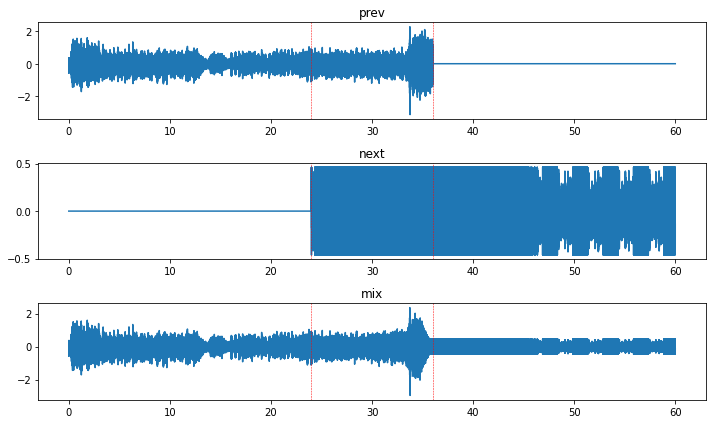

cue in: 0:24.00
cue out: 0:36.00


In [15]:
fig, axs = plt.subplots(3, 1, figsize=(10, 6))
cue_timestamps = squeeze_dim(cue)*settings.N_TIME

wave_visualize(squeeze_dim(pair_audio[0]), axs[0], timestamps=cue_timestamps, title='prev')
wave_visualize(squeeze_dim(pair_audio[1]), axs[1], timestamps=cue_timestamps, title='next')
wave_visualize(squeeze_dim(mix_audio)    , axs[2], timestamps=cue_timestamps, title='mix')

plt.tight_layout()
plt.show()

for (cue_timestamp, cue_type) in zip(cue_timestamps, ['cue in', 'cue out']):
    print(f'{cue_type}: {time_to_str(cue_timestamp)}')

audio_visualize(mix_audio)

### Inference from provided track

In [5]:
prev_path  = './test/Breikthru ft Danny Devinci-Touch.mp3'
prev_cue   = 96  # cue out
prev_audio = load_audio(prev_path)

next_path  = './test/Jameson-Hangin.mp3'
next_cue   = 30  # cue out
next_audio = load_audio(next_path)

### Preprocessing

In [6]:
(pair_audio, timestamps), (pair_audio_for_g, cue_for_g) = preprocess(prev_audio, next_audio, prev_cue, next_cue)
mix_audio, mix_out = generator.infer(*pair_audio_for_g, cue_region=cue_for_g)

[1/5] beat tracking start ...
[1/5] beat tracking complete ...
[2/5] bpm matching start ...
[2/5] bpm matching complete ...
[3/5] cue point select start ...
[3/5] cue point select complete ...
[4/5] cue region alignment start ...
[4/5] cue region alignment complete ...
[5/5] normalize start ...
[5/5] normalize complete ...


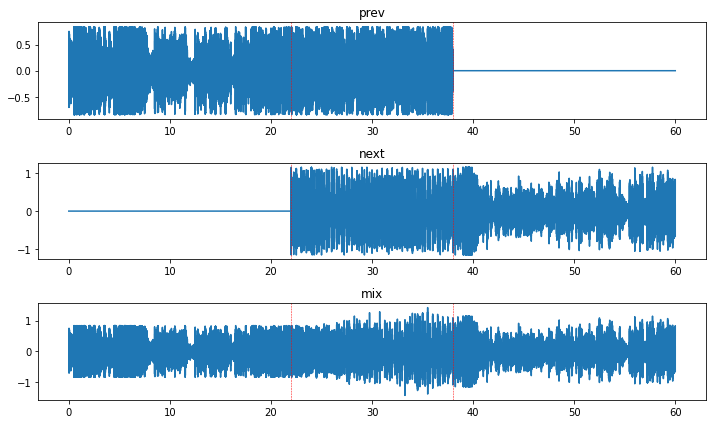

cue in: 0:22.00
cue out: 0:38.00


In [7]:
cue_timestamps = squeeze_dim(cue_for_g)*settings.N_TIME

fig, axs = plt.subplots(3, 1, figsize=(10, 6))
wave_visualize(squeeze_dim(pair_audio_for_g[0]), axs[0], timestamps=cue_timestamps, title='prev')
wave_visualize(squeeze_dim(pair_audio_for_g[1]), axs[1], timestamps=cue_timestamps, title='next')
wave_visualize(squeeze_dim(mix_audio)          , axs[2], timestamps=cue_timestamps, title='mix')

plt.tight_layout()
plt.show()

for (cue_timestamp, cue_type) in zip(cue_timestamps, ['cue in', 'cue out']):
    print(f'{cue_type}: {time_to_str(cue_timestamp)}')

audio_visualize(mix_audio)

### Postprocessing

In [8]:
post_mix_audio, post_cue = postprocess(mix_audio, pair_audio, timestamps, cue_for_g)

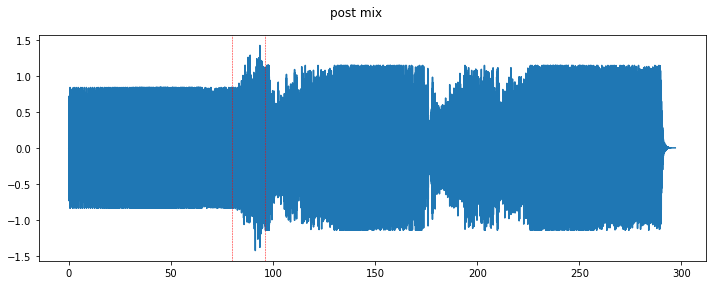

cue in: 1:20.05
cue out: 1:36.05


In [9]:
fig = plt.figure(figsize=(10, 4))

wave_visualize(post_mix_audio, plt, timestamps=post_cue)


plt.suptitle('post mix')
plt.tight_layout()
plt.show()

for (cue, cue_type) in zip(post_cue, ['cue in', 'cue out']):
    print(f'{cue_type}: {time_to_str(cue)}')

audio_visualize(post_mix_audio)